## Conways game of life 
---

One of the first projects in python where I ever really got my hands dirty was to implement Conways game of life. My code worked but it was **terrible**,an unreadable stack overflow Frankentein of a thing . No functions ,no classes , just reems of nested gibberish.So I decided to make it right and take another stab at Conway.

###About the game of life 

Conways game of life (not to be confused with [this](https://cf.geekdo-images.com/images/pic288405_md.jpg)), is a an automated simulation of cells on a two dimensional grid.These cells can have two states ,alive or dead. The fate of each cell is determined by the number of "neighbours" it has on the grid. The impact neighbours has is summed up by the following four rules 

* Rule 1 :Any live cell with fewer than two live neighbours dies, as if caused by under-population.
* Rule 2 :Any live cell with two or three live neighbours lives on to the next generation.
* Rule 3 :Any live cell with more than three live neighbours dies, as if by overcrowding.
* Rule 4 :Any dead cell with exactly three live neighbours becomes a live cell, as if by reproduction.

Conway is a great problem to start thinking about programming and computer systems. You have data that exist in a data structure, existingin a binary state and that  requires iteration uisng a simple ,well defined Algorithm.For a beginner,it's a fun but challenging project to tackle.


### The code 
---
For this implementation, I decided to make a more visual version so I'm going to use Matplotlib and it's animation features in Ipython notebook,this is also a great chance to test out Githubs recently added Ipnb support I'll include it bit by bit while explaining what I'm doing. first up dependencies 

In [1]:
import numpy as np 
import matplotlib.pyplot as plt
import matplotlib.animation as anim

 what I've done here is pull in some modules we'll need to go ahead.It should be noted that these are not standard libraries and do not come with python . If you're on a Mac/linux machine , open up terminal and type `pip install numpy` and `pip install matplotlib` after that they'll be available to use. The `as` statement is another interesting point it allows you to create a shorthand for using importing modules in code. So instead of typing `matplotlib.pyplot` everytime I want to use the module I can just type `plt`.
I'll describe briefly what each module does before we continue. 

`Numpy` is an extension to Python that focuses on scientific computing. What makes it really good for the game of life is it's N dimensional Array, which is a really quick and powerful way to build and populate  our grid.In standard python the alternatives are lists within lists(which are a pain and slow) or a dictionary of x,y coordinates (even slower). 

`matplotlib` is a package aimed at data visualisation and graphing it has great animation and ipython notebook support. If you wanted to do a more tradtional standalone program using python `tkinter` or `pygame` would be good options. 


Now that I've got the modules I'll need. I can start by putting together the grid, this is where numpy comes in handy



In [2]:
n= 50   
alive = 1
dead = 0 
states = [alive,dead]

world =np.random.choice(states,n*n,p=[0.2,0.8])

This creates the cells I need , but their arrangement is wrong if I look at this with a `print` statement I get :

In [3]:
print world 

[0 0 0 ..., 0 1 0]


to fix this I need to use `.reshape()` this will change the one dimensional array of data point into a two dimensional matrix. So redifining `world` with reshape looks like this :

In [4]:
world = np.random.choice(states,n*n,p=[0.6,0.4]).reshape(n,n)
print world 

[[1 1 1 ..., 1 1 1]
 [1 1 1 ..., 1 0 0]
 [1 1 1 ..., 1 0 0]
 ..., 
 [1 0 1 ..., 1 1 1]
 [1 1 1 ..., 1 0 1]
 [0 0 1 ..., 0 0 1]]


This sets up a 50 by 50 of one's and zero's (alive and dead) . The choice function picks values from the states array,the `p` value weights the choice so it's more likeley to pick live than dead states, if it was predominantly dead cells not very much would happen. 
This array will be the board the game is played on, the next step is to express the four rules in python and to iterate across the array.

In [5]:
def gol(data):
    global world # brings the global world variable down to this scope 
    newWorld =world.copy() 
    for i in range(n):
        for j in range (n): 
            total = (world[i, (j-1)%n] + world[i, (j+1)%n] + 
            world[(i-1)%n, j] + world[(i+1)%n, j] + 
            world[(i-1)%n, (j-1)%n] + world[(i-1)%n, (j+1)%n] + 
            world[(i+1)%n, (j-1)%n] + world[(i+1)%n, (j+1)%n])
            if world [i,j] == alive :
                if (total < 2)  or (total >3): #rule for overpopulation & loneliness 
                    newWorld[i,j] = dead
            else:
                if total == 3:  # rule for reproduction
                    newWorld[i,j] = alive 
    mat.set_data(newWorld)
    world = newWorld
    return [mat]
    

Now that we have a function written out the next step is to visualise the game in this notebook. On a normal python console matplotlib would be enough. but to embed into an ipython notebook I'll need to use something else. JCAnimation is a great little plugin that does just that.The source code is available [here](https://github.com/jakevdp/JSAnimation).You can install it with pip using the following command (note you made need to use the `sudo` command to install this):
         

`pip install git+https://github.com/jakevdp/JSAnimation`


with this installed the next step is to import it 

In [6]:
from JSAnimation import IPython_display

What this does is take matplotlib animations and convert them into web elements that play nice with the notebook 


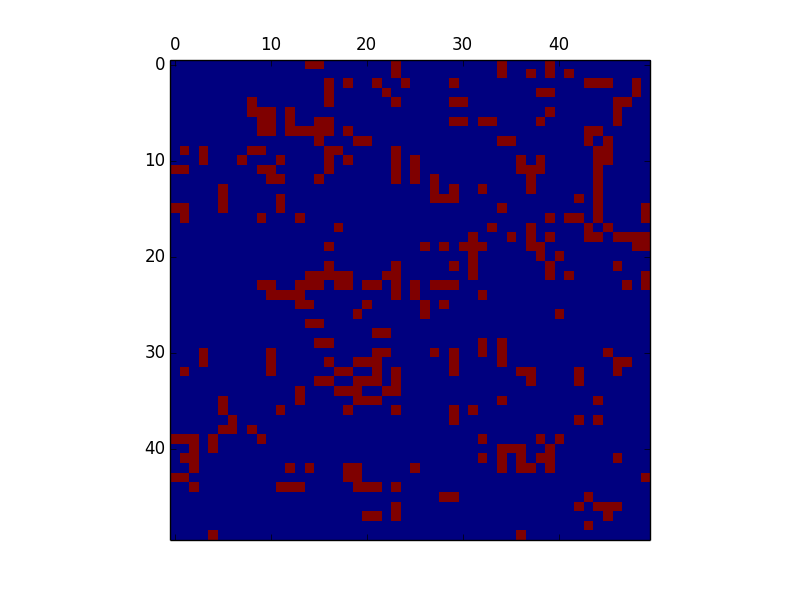
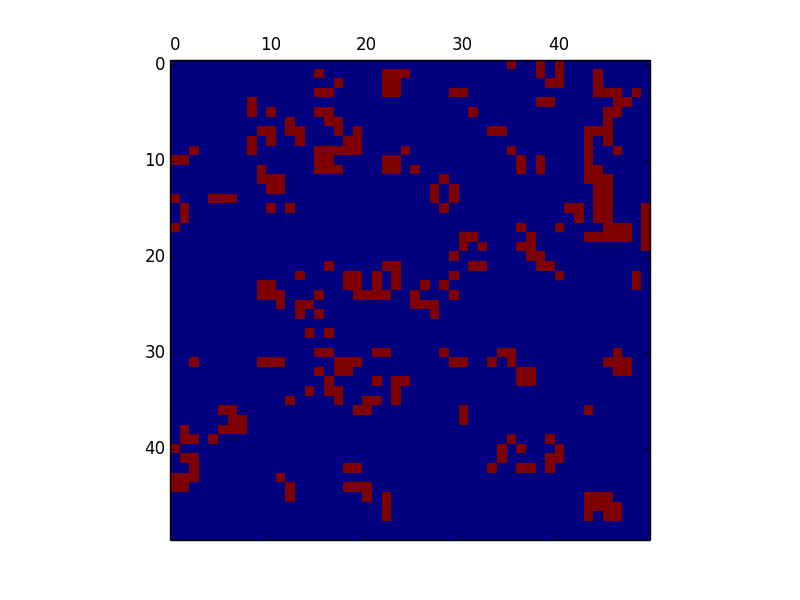
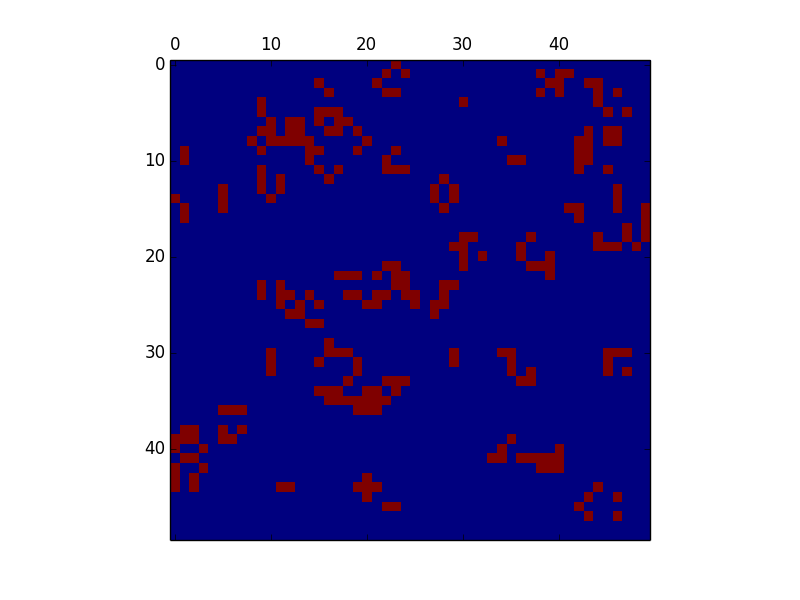
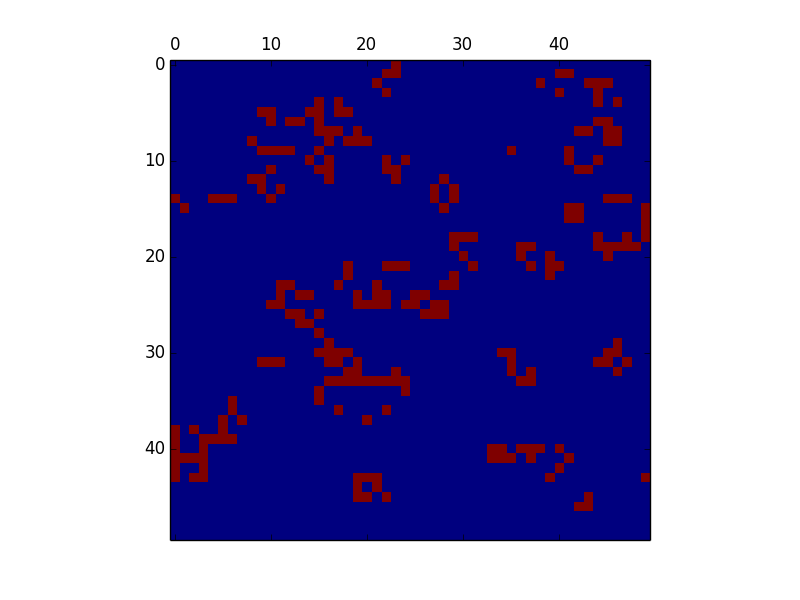
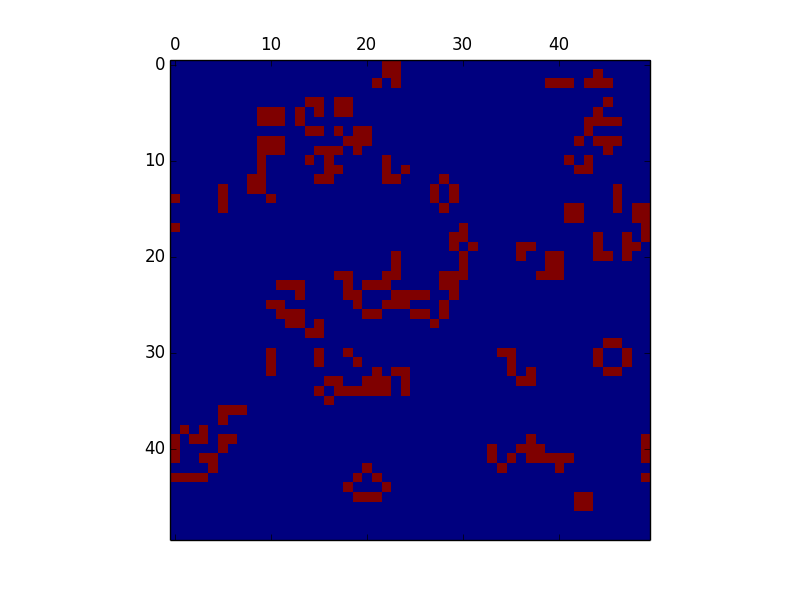
...
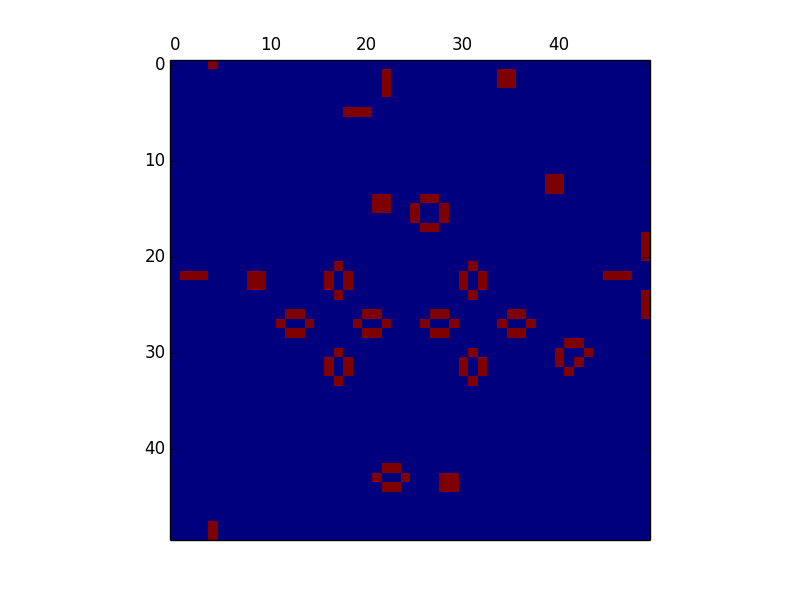
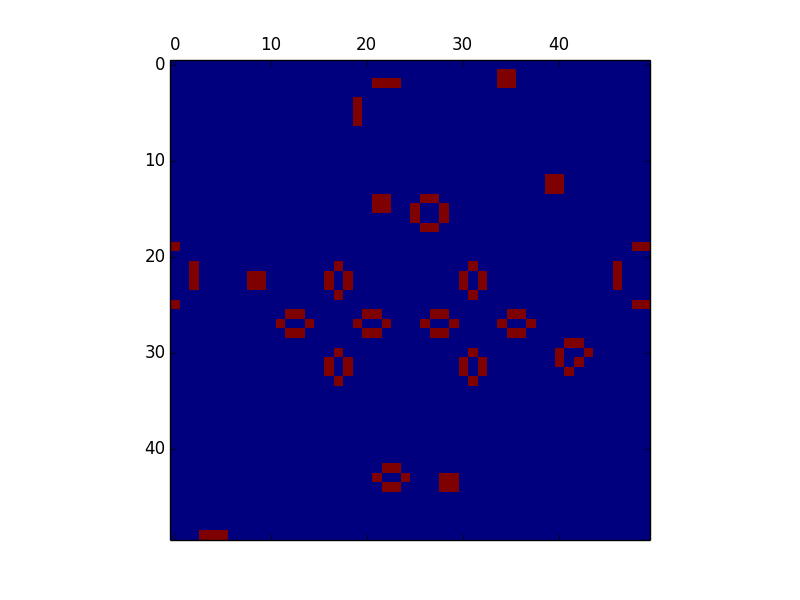
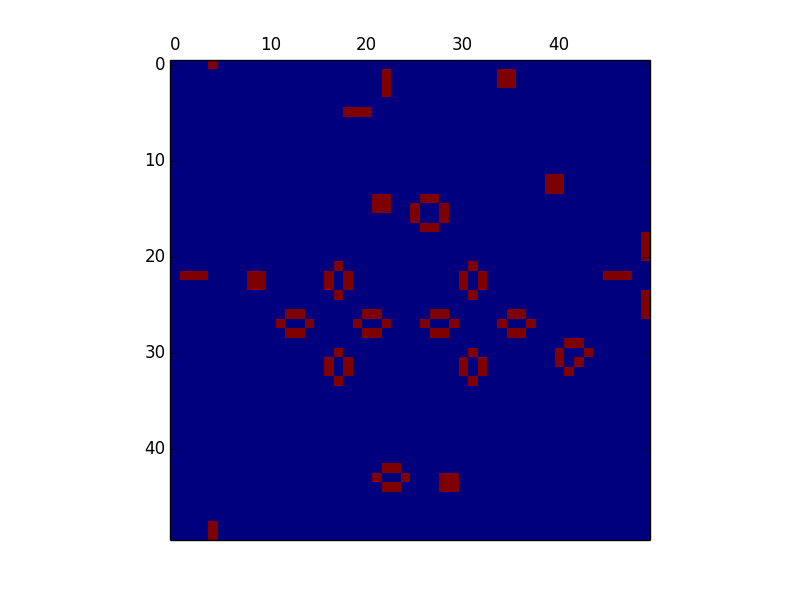
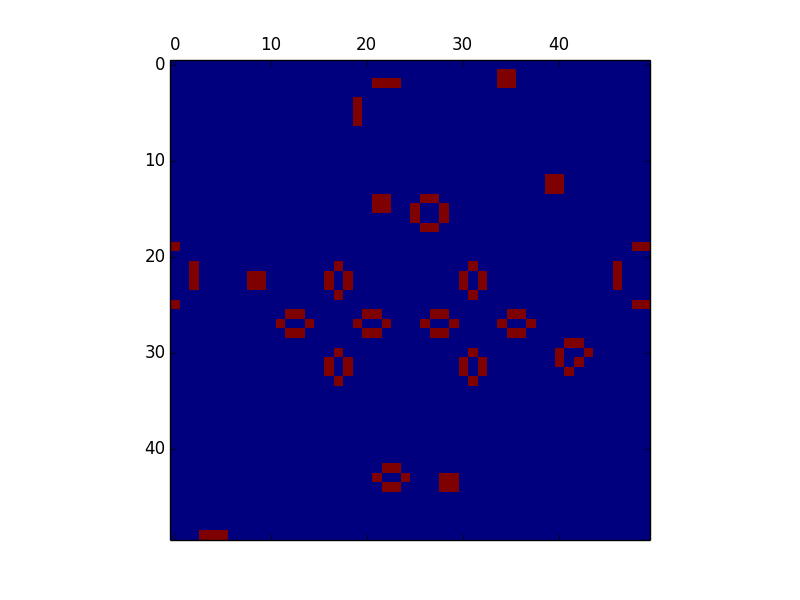
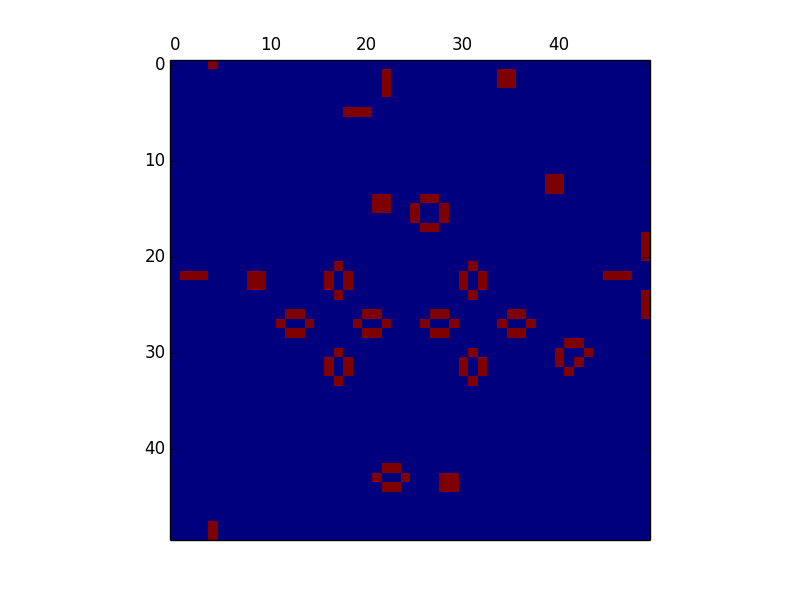

In [7]:
fig,ax =plt.subplots()
mat = ax.matshow(world)

def init():
    mat.set_data(world)
    
anim.FuncAnimation(fig,gol,init_func =init, interval =50,save_count = 2000)

